In [1]:
# from __future__ import division, print_function
import sys, os, glob, time, warnings, gc
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Table, vstack, hstack
import fitsio
# from astropy.io import fits

In [2]:
params = {'legend.fontsize': 'x-large',
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large',
         'figure.facecolor':'w'} 
plt.rcParams.update(params)

In [3]:
brickname = '2239p455'
coadd_dir = '/global/cfs/cdirs/cosmo/work/legacysurvey/dr9m/north/coadd/{}/{}'.format(brickname[:3], brickname)
metrics_dir = '/global/cfs/cdirs/cosmo/work/legacysurvey/dr9m/north/metrics/{}'.format(brickname[:3])

vranges = {'g':0.015, 'r':0.03, 'z':0.05, 'W1':15, 'W2':40}

--------
# Optical

In [4]:
band = 'g'
vrange = vranges[band]

img_path = glob.glob(os.path.join(coadd_dir, '*-image-{}.fits.fz'.format(band)))[0]
model_path = glob.glob(os.path.join(coadd_dir, '*-model-{}.fits.fz'.format(band)))[0]
blobmodel_path = glob.glob(os.path.join(coadd_dir, '*-blobmodel-{}.fits.fz'.format(band)))[0]
maskbits_path = glob.glob(os.path.join(coadd_dir, '*-maskbits.fits.fz'))[0]
blob_path = glob.glob(os.path.join(metrics_dir, 'blobs-{}.fits.gz'.format(brickname)))[0]

In [5]:
img = fitsio.read(img_path)
model = fitsio.read(model_path)
blobmodel = fitsio.read(blobmodel_path)
maskbits = fitsio.read(maskbits_path)
blob = fitsio.read(blob_path)
blob = blob!=-1

print(img.shape)

(3600, 3600)


In [6]:
binsize = 3
trim_size_x = img.shape[1] % binsize
trim_size_y = img.shape[0] % binsize
img = img[:(img.shape[0]-trim_size_y), :(img.shape[1]-trim_size_x)]
img = np.nanmean(np.nanmean(img.reshape((img.shape[0]//binsize, binsize, img.shape[1]//binsize,-1)), axis=3), axis=1)
model = model[:(model.shape[0]-trim_size_y), :(model.shape[1]-trim_size_x)]
model = np.nanmean(np.nanmean(model.reshape((model.shape[0]//binsize, binsize, model.shape[1]//binsize,-1)), axis=3), axis=1)
blobmodel = blobmodel[:(blobmodel.shape[0]-trim_size_y), :(blobmodel.shape[1]-trim_size_x)]
blobmodel = np.nanmean(np.nanmean(blobmodel.reshape((blobmodel.shape[0]//binsize, binsize, blobmodel.shape[1]//binsize,-1)), axis=3), axis=1)
maskbits = maskbits[:(maskbits.shape[0]-trim_size_y), :(maskbits.shape[1]-trim_size_x)]
maskbits = np.max(np.max(maskbits.reshape((maskbits.shape[0]//binsize, binsize, maskbits.shape[1]//binsize,-1)), axis=3), axis=1)
blob = np.min(np.min(blob.reshape((blob.shape[0]//binsize, binsize, blob.shape[1]//binsize,-1)), axis=3), axis=1)

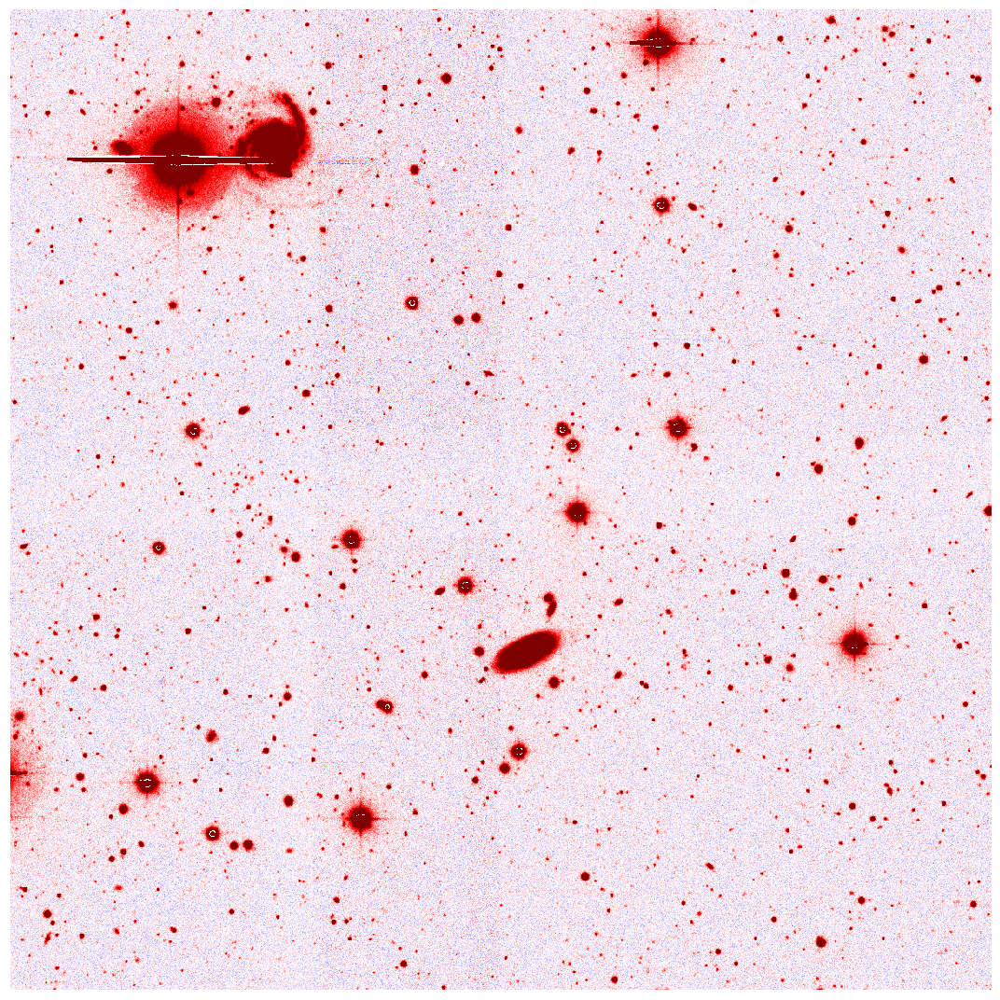

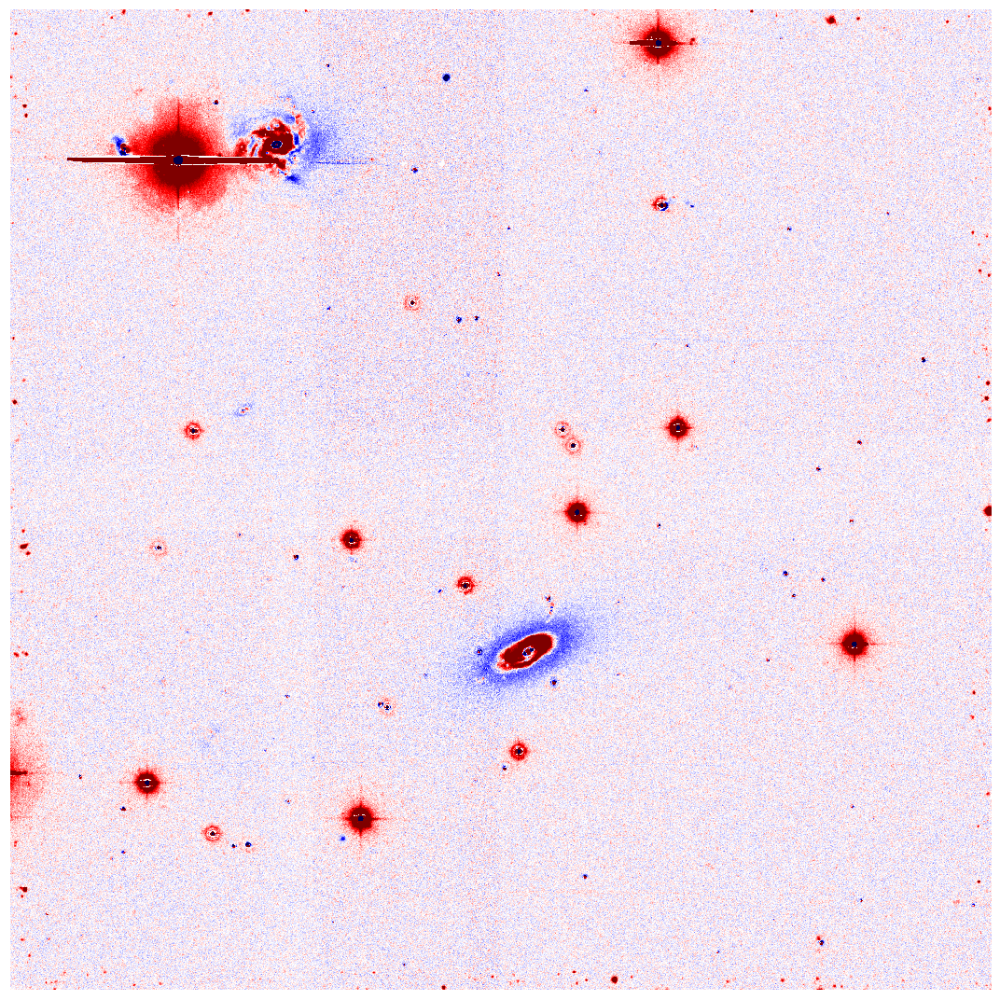

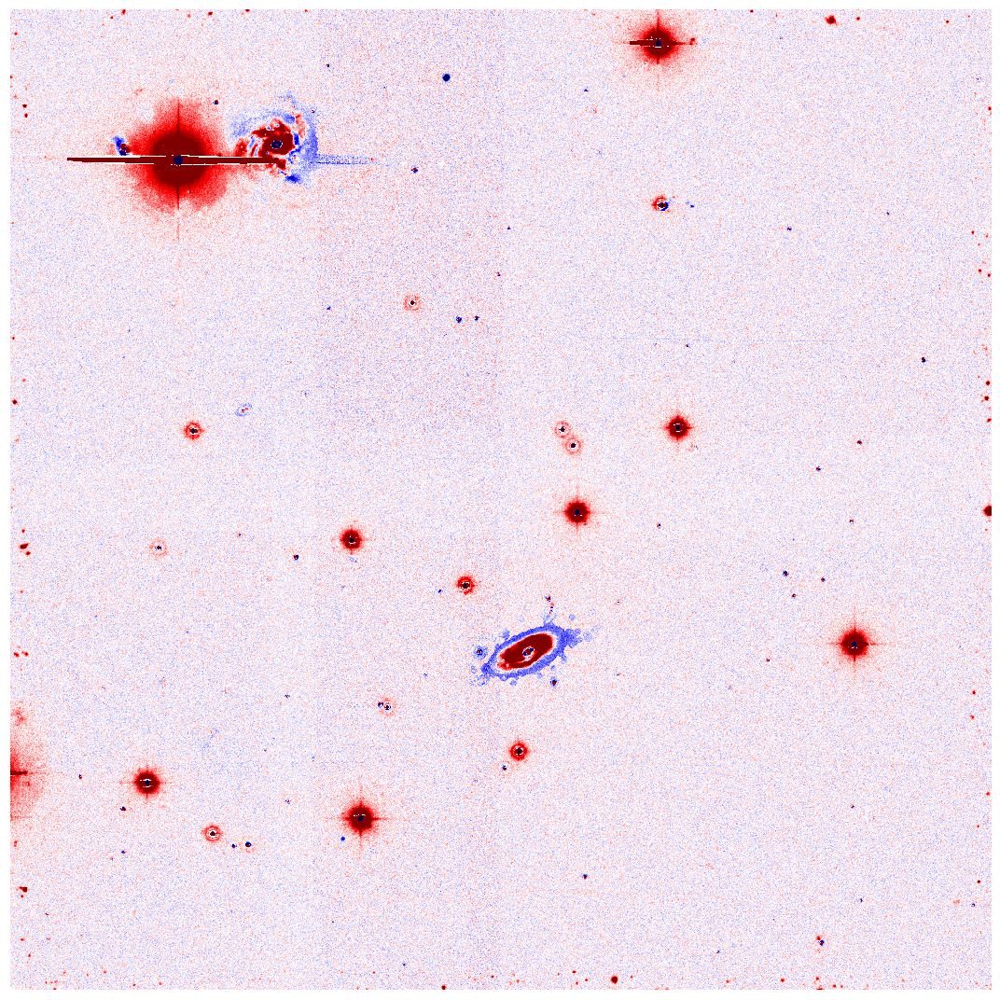

In [7]:
plt.figure(figsize=(15, 15))
fig = plt.imshow(img, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_img.png'.format(brickname, band))
plt.show()

plt.figure(figsize=(15, 15))
fig = plt.imshow(img-model, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_resid.png'.format(brickname, band))
plt.show()

plt.figure(figsize=(15, 15))
fig = plt.imshow(img-blobmodel, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_blobresid.png'.format(brickname, band))
plt.show()

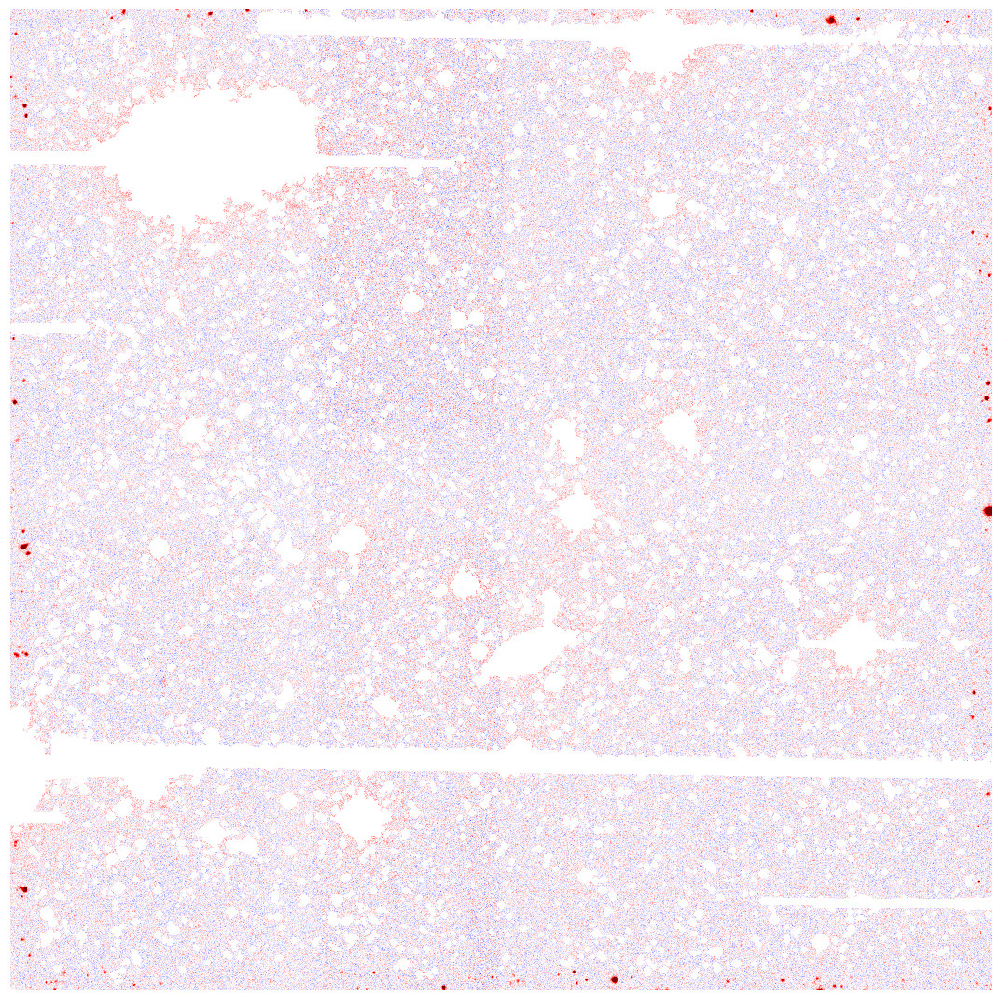

In [8]:
img1 = img.copy()
img1[blob] = np.nan

plt.figure(figsize=(15, 15))
fig = plt.imshow(img1, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_img_blobmask.png'.format(brickname, band))
plt.show()

0.0116826388889


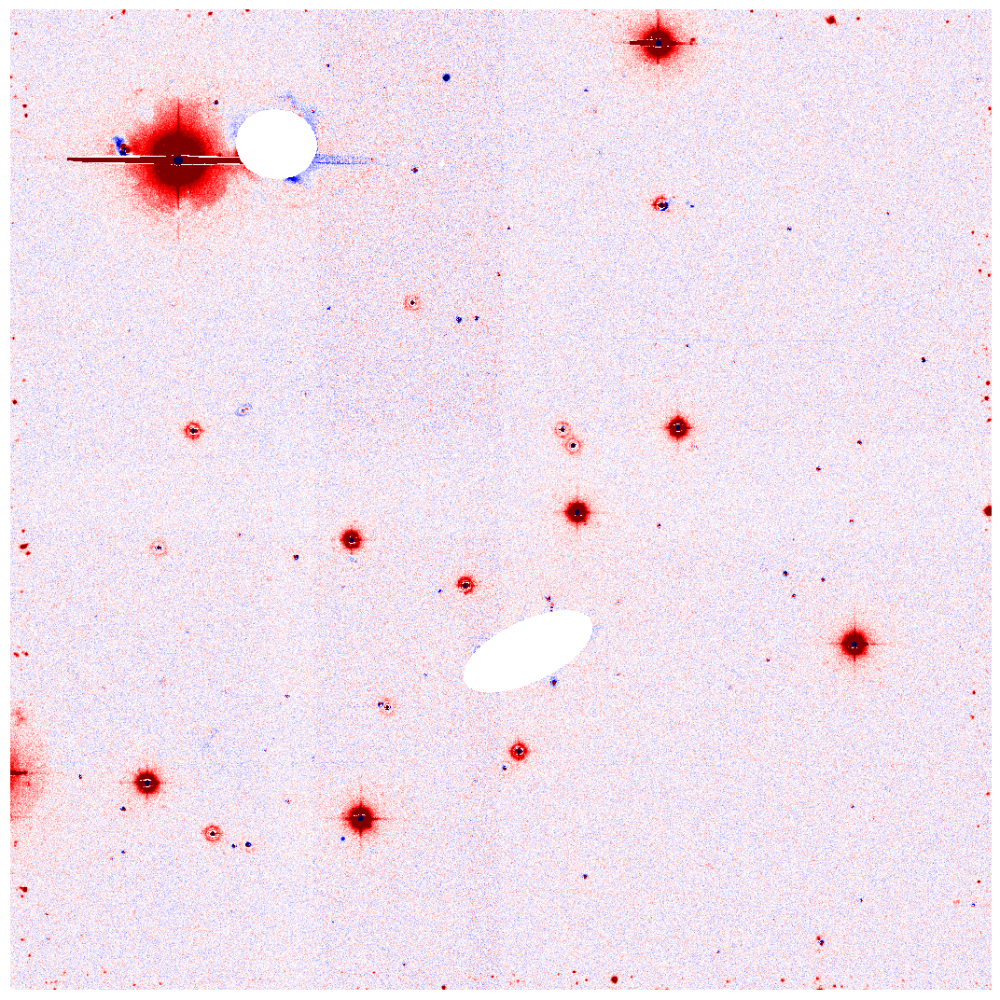

In [9]:
bits = [12]
mask_clean = np.ones_like(img, dtype=bool)
for bit in bits:
    mask_clean &= (maskbits & 2**bit)==0
print(np.sum(~mask_clean)/np.product([mask_clean.shape]))

img1 = img.copy()
img1[~mask_clean] = np.nan
plt.figure(figsize=(15, 15))
fig = plt.imshow(img1-blobmodel, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_blobresid_galaxy_mask.png'.format(brickname, band))
plt.show()

0.0141805555556


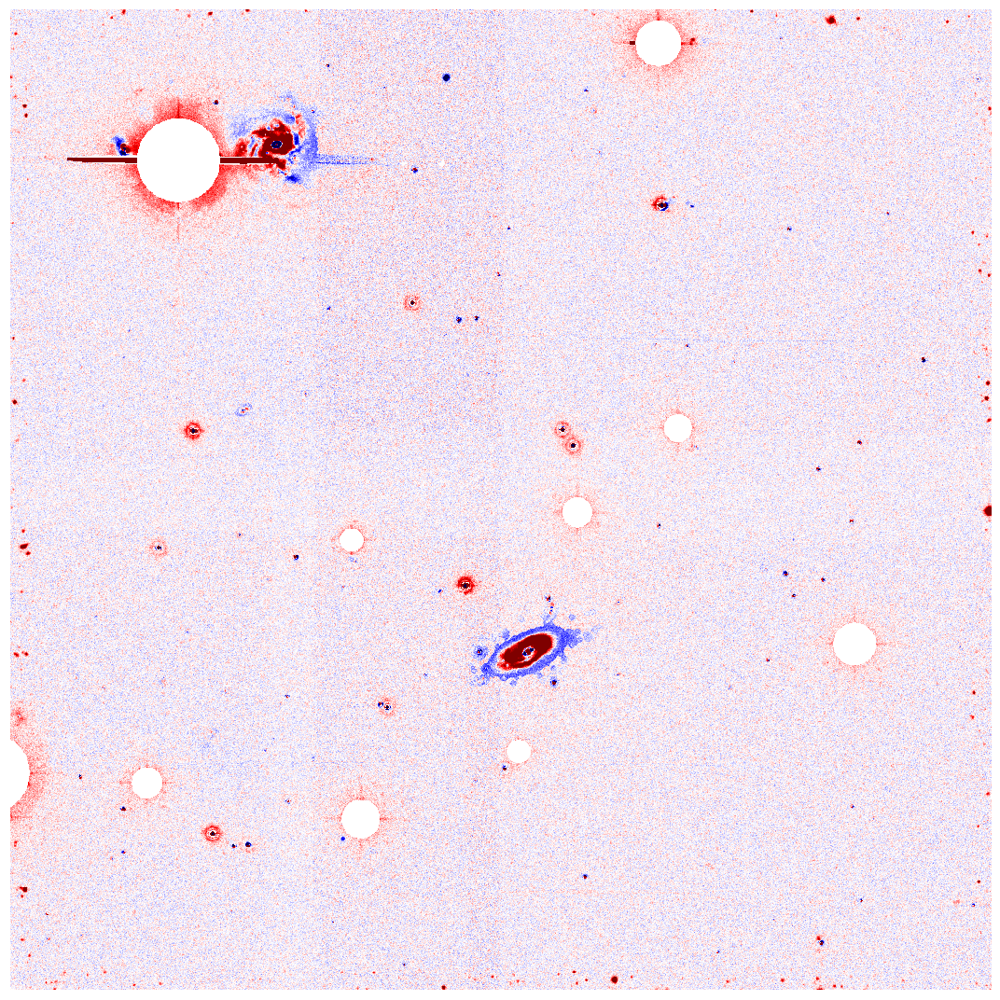

In [10]:
bits = [1]
mask_clean = np.ones_like(img, dtype=bool)
for bit in bits:
    mask_clean &= (maskbits & 2**bit)==0
print(np.sum(~mask_clean)/np.product([mask_clean.shape]))

img1 = img.copy()
img1[~mask_clean] = np.nan
plt.figure(figsize=(15, 15))
fig = plt.imshow(img1-blobmodel, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_blobresid_bright_star.png'.format(brickname, band))
plt.show()

0.07073125


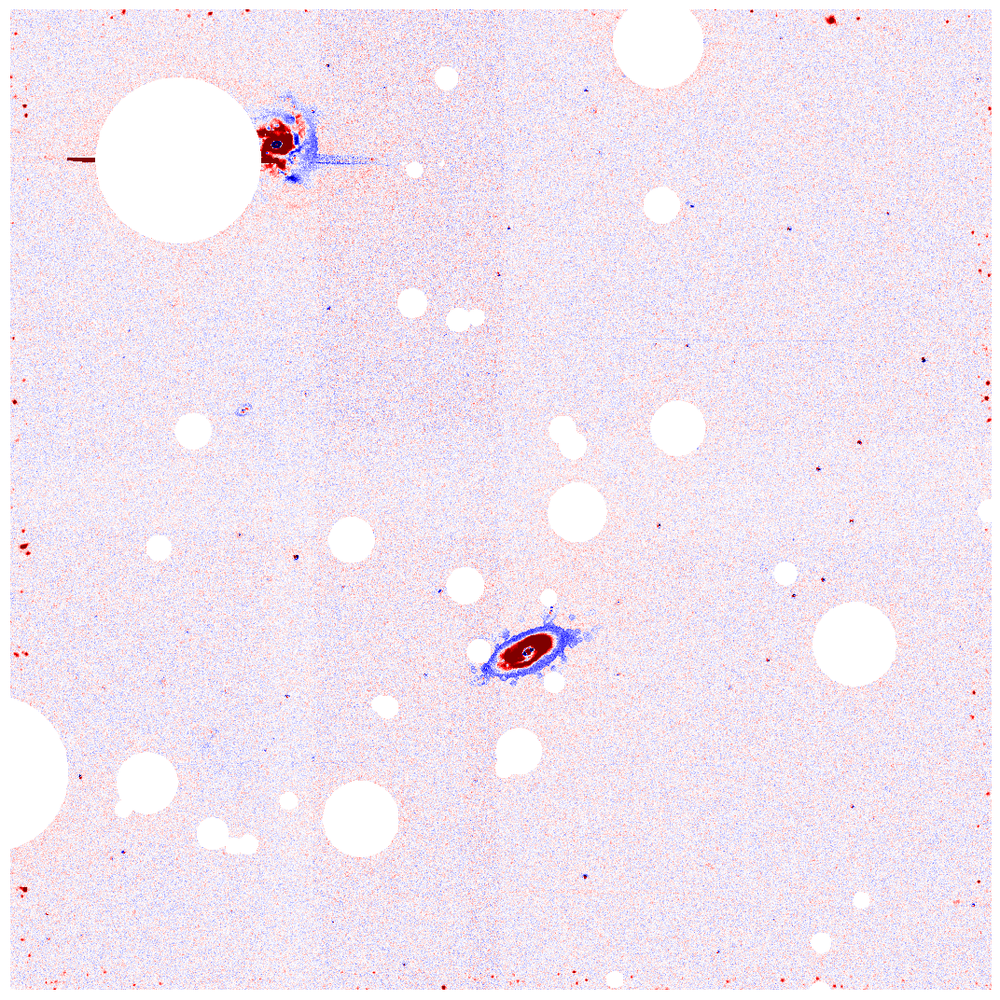

In [11]:
bits = [1, 11]
mask_clean = np.ones_like(img, dtype=bool)
for bit in bits:
    mask_clean &= (maskbits & 2**bit)==0
print(np.sum(~mask_clean)/np.product([mask_clean.shape]))

img1 = img.copy()
img1[~mask_clean] = np.nan
plt.figure(figsize=(15, 15))
fig = plt.imshow(img1-blobmodel, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_blobresid_bright_and_medium_star.png'.format(brickname, band))
plt.show()

--------
# WISE

In [12]:
band = 'W1'
vrange = vranges[band]

img_path = glob.glob(os.path.join(coadd_dir, '*-image-{}.fits.fz'.format(band)))[0]
model_path = glob.glob(os.path.join(coadd_dir, '*-model-{}.fits.fz'.format(band)))[0]

img = fitsio.read(img_path)
model = fitsio.read(model_path)

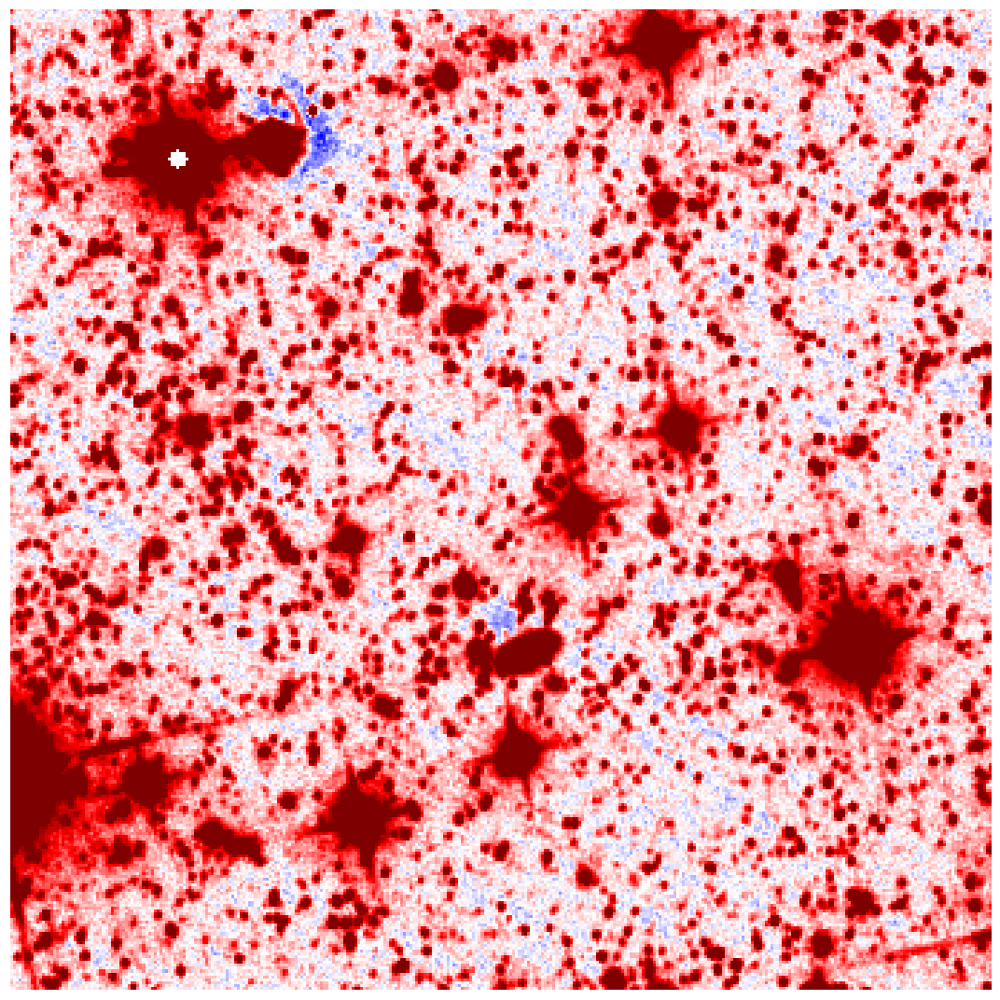

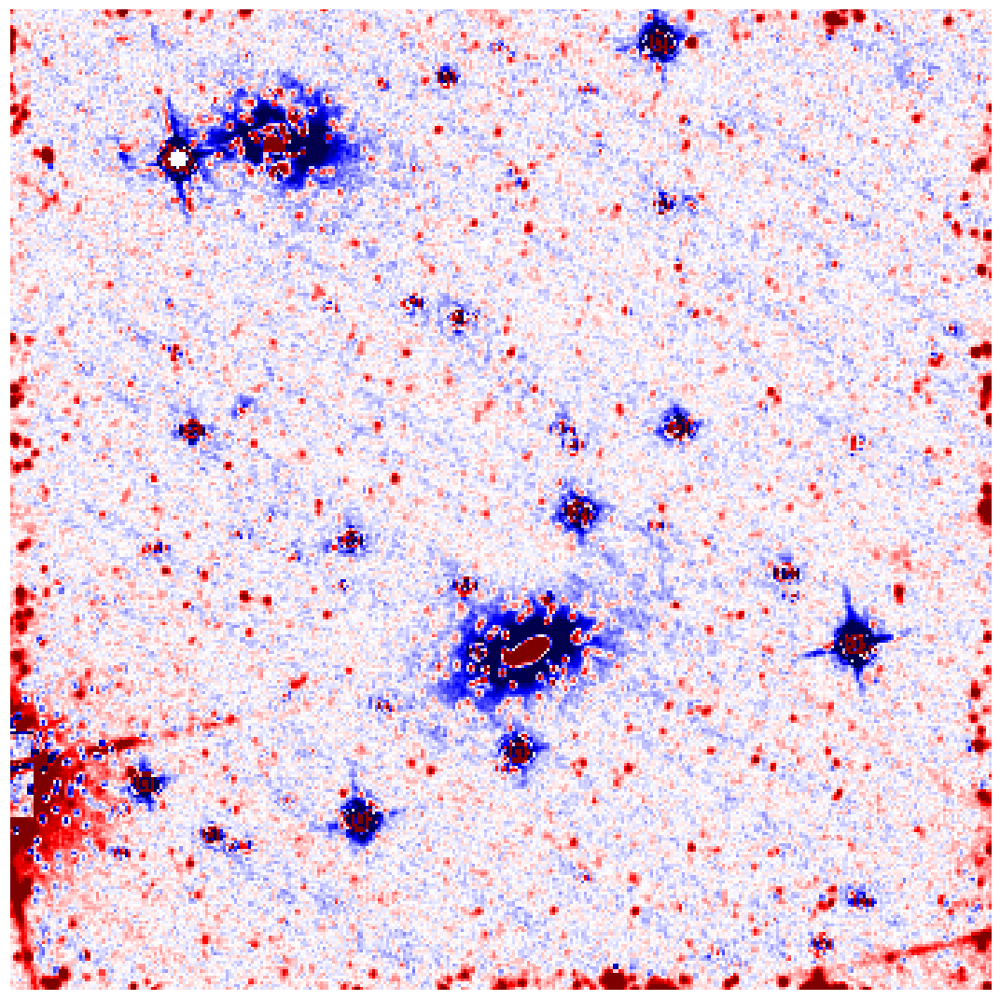

In [13]:
plt.figure(figsize=(15, 15))
fig = plt.imshow(img, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_img.png'.format(brickname, band))
plt.show()

plt.figure(figsize=(15, 15))
fig = plt.imshow(img-model, cmap='seismic', vmin=-vrange, vmax=vrange)
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
plt.savefig('coadd_plots/{}_{}_resid.png'.format(brickname, band))
plt.show()